In [1]:
import sys
import torch
import torch.utils.data
from torch import nn, optim
from torch.nn import functional as F
from torchvision import datasets, transforms
from torchvision.utils import make_grid
from tqdm import tqdm

In [2]:
import matplotlib.pyplot as plt
import numpy as np

def show(img, title, size):
    npimg = img.numpy()
    plt.figure(figsize=size, dpi=200)
    plt.title(title)
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')
    plt.show()

# CelebA Data

In [3]:
LEARNING_RATE = 1e-4
BETAS = (0.5, 0.999)
BATCH_SIZE = 128

In [4]:
from data import CelebA
dataset = CelebA(transform=transforms.Compose([
                    transforms.CenterCrop(178),
                    transforms.Resize((256, 256)), 
                    transforms.ToTensor()]))

In [5]:
idcs = np.arange(len(dataset))
np.random.seed(0) # This is important to split the same way every single time
np.random.shuffle(idcs)
split_idx = int(0.9 * len(dataset))
train_idcs = idcs[:split_idx]
test_idcs = idcs[split_idx:]

In [6]:
train_dataset = torch.utils.data.Subset(dataset, train_idcs)
test_dataset = torch.utils.data.Subset(dataset, test_idcs)

Toggle debug mode dataset:

In [7]:
train_loader = torch.utils.data.DataLoader(train_dataset,
    batch_size=BATCH_SIZE, shuffle=True, num_workers=4)
test_loader = torch.utils.data.DataLoader(test_dataset,
    batch_size=BATCH_SIZE, shuffle=True, num_workers=4)

# FaderNetwork Model

In [8]:
from models import FaderAE
from models import Classifier

In [9]:
device = torch.device("cuda")

In [10]:
num_attributes = train_dataset[0][1].shape[0]
num_channels = train_dataset[0][0].shape[0]

In [11]:
ae_model = FaderAE(num_attributes=num_attributes, num_channels=num_channels).to(device)
disc_model = Classifier(input_dimensionality=ae_model.latent_space, output_dimensionality=num_attributes).to(device)
ae_optim = optim.Adam(ae_model.parameters(), lr=LEARNING_RATE, betas=BETAS)
disc_optim = optim.Adam(disc_model.parameters(), lr=LEARNING_RATE, betas=BETAS)

In [12]:
ae_model

FaderAE(
  (convs): Sequential(
    (0): Conv2d(3, 16, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(16, 32, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Conv2d(32, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(64, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Conv2d(128, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), bias=False)
    (13): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (14): ReLU()

In [13]:
disc_model

Classifier(
  (fc1): Linear(in_features=50, out_features=100, bias=True)
  (fc2): Linear(in_features=100, out_features=100, bias=True)
  (fc3): Linear(in_features=100, out_features=46, bias=True)
  (fc4): Linear(in_features=46, out_features=43, bias=True)
  (fc5): Linear(in_features=43, out_features=40, bias=True)
)

In [14]:
from torch.autograd import Variable

def train(epoch):
    ae_model.train()
    disc_model.train()

    sum_disc_loss = 0
    sum_disc_acc = 0
    sum_rec_loss = 0
    sum_adv_loss = 0
    sum_fader_loss = 0
    
    final_disc_penal_weight = 0.1*256*256

    for data, labels in tqdm(train_loader):
        
        data = data.to(device)
        labels = labels.to(device).float().reshape(labels.shape[0], -1)

        # Encode data
        z = ae_model.encode(data)
        
        # Train discriminator
        disc_optim.zero_grad()
        label_preds = disc_model(z)
        disc_loss = F.binary_cross_entropy(label_preds, labels, reduction='sum')
        sum_disc_loss += disc_loss.item()

        disc_loss.backward()
        disc_optim.step()
        
        # Compute discriminator accuracy
        disc_acc = torch.sum((label_preds > 0.5) == (labels > 0.5), dim=0).float()
        sum_disc_acc += disc_acc
        
        # Compute discriminator penalization weight based on schedule
        curr_disc_penal_weight = min(final_disc_penal_weight, 100 * epoch) 
        
        # Compute fader loss
        ae_model.zero_grad()

        z = ae_model.encode(data)
        reconst_batch = ae_model.decode(z, labels)
        rec_loss = F.mse_loss(reconst_batch, data, reduction='sum')
        sum_rec_loss += rec_loss.item()
        
        label_preds_to_fool = disc_model(z)
        adv_loss = F.binary_cross_entropy(label_preds_to_fool, labels, reduction='sum')
        sum_adv_loss += adv_loss.item()
        
        fader_loss = rec_loss - curr_disc_penal_weight*adv_loss
        sum_fader_loss += fader_loss.item()        
        
        # Train auto encoder
        fader_loss.backward()
        ae_optim.step()
        
        
    train_size = len(train_loader.dataset)
    print('====> Epoch: {} Fader Loss: {:.4f} | Adv Loss: {:.4f} | Rec Loss: {:.4f} \n\t| Adj Disc Loss: {:.4f} \n\t| Disc Acc: {}'.format(
          epoch, sum_fader_loss/train_size, sum_adv_loss/train_size, 
        sum_rec_loss/train_size, curr_disc_penal_weight*sum_disc_loss/train_size, sum_disc_acc/train_size))
    sys.stdout.flush()

def test(epoch):
    ae_model.eval()
    disc_model.eval()
    with torch.no_grad():
        for data_batch, label_batch in tqdm(test_loader):
            
            label_batch = label_batch.reshape(label_batch.shape[0], -1)
            
            N_SAMPLES_PER_FADER_COMBINATION = 5
            N_ATTRIBUTES = label_batch.shape[1]
            N_CHANNELS = data_batch[0].shape[0]
            
            data_batch = data_batch.to(device)[:N_SAMPLES_PER_FADER_COMBINATION]
            label_batch = label_batch.to(device)[:N_SAMPLES_PER_FADER_COMBINATION]
            z_batch = ae_model.encode(data_batch)
            
            faders = torch.zeros(((1+1+N_ATTRIBUTES)*N_SAMPLES_PER_FADER_COMBINATION, N_ATTRIBUTES)).to(device)
            faders[0:N_SAMPLES_PER_FADER_COMBINATION, :] = label_batch
            
            z_faders = torch.zeros(((1+1+N_ATTRIBUTES)*N_SAMPLES_PER_FADER_COMBINATION, z_batch.shape[1])).to(device)
            for i in range(N_SAMPLES_PER_FADER_COMBINATION, faders.shape[0], N_SAMPLES_PER_FADER_COMBINATION):
                z_faders[(i-N_SAMPLES_PER_FADER_COMBINATION):i, :] = z_batch
            z_faders[-N_SAMPLES_PER_FADER_COMBINATION:, :] = z_batch
                
            curr_attr_idx = 0
            for i in range(2*N_SAMPLES_PER_FADER_COMBINATION, faders.shape[0]):
                faders[i, curr_attr_idx] = 1
                if (i-(2*N_SAMPLES_PER_FADER_COMBINATION)) // N_SAMPLES_PER_FADER_COMBINATION > curr_attr_idx:
                    curr_attr_idx += 1
                                        
            show(make_grid(data_batch.detach().cpu(), nrow=N_SAMPLES_PER_FADER_COMBINATION), 'True {}'.format(epoch), size=(10, 5))
            
            fader_reconst = ae_model.decode(z_faders, faders).cpu()
            show(make_grid(fader_reconst.view(-1, N_CHANNELS, 256, 256), nrow=N_SAMPLES_PER_FADER_COMBINATION), 'Fader Reconst {}'.format(epoch), size=(10, 80))
            break

In [15]:
dataset = train_loader.dataset

In [16]:
ae_path = 'weights/{}_{}.pt'.format(ae_model.__class__.__name__, dataset.__class__.__name__)
ae_path

'weights/FaderAE_Subset.pt'

In [17]:
epochs_trained_path = ae_path[:-3] + '_epochs.npy'
epochs_trained_path

'weights/FaderAE_Subset_epochs.npy'

In [18]:
disc_path = 'weights/{}_{}.pt'.format(disc_model.__class__.__name__, dataset.__class__.__name__)
disc_path

'weights/Classifier_Subset.pt'

In [19]:
def save(epoch):
    torch.save(ae_model.state_dict(), ae_path)
    torch.save(disc_model.state_dict(), disc_path)
    np.save(epochs_trained_path, epoch)

In [20]:
import os

def load():
    epochs_trained = 0
    if os.path.exists(ae_path) and os.path.exists(disc_path) and os.path.exists(epochs_trained_path):
        ae_model.load_state_dict(torch.load(ae_path))    
        disc_model.load_state_dict(torch.load(disc_path))
        epochs_trained = np.load(epochs_trained_path) + 1
        print("Loaded with {} epochs trained".format(epochs_trained))
    else:
        print("Starting from scratch")
    return epochs_trained

# Train

### Try to load if possible

In [21]:
epochs_trained = load()

Starting from scratch


### Train!

In [22]:
epochs = 1000

100%|██████████| 1425/1425 [25:05<00:00,  1.06it/s]

====> Epoch: 0 Fader Loss: 4879.1254 | Adv Loss: 18.6423 | Rec Loss: 4879.1254 
	| Adj Disc Loss: 0.0000 
	| Disc Acc: tensor([0.8408, 0.7209, 0.5476, 0.7824, 0.9231, 0.8458, 0.7448, 0.7397, 0.7459,
        0.8505, 0.9181, 0.7591, 0.8492, 0.9012, 0.9043, 0.8767, 0.9349, 0.9576,
        0.6078, 0.5238, 0.5699, 0.5044, 0.9575, 0.8569, 0.8314, 0.6875, 0.9182,
        0.7011, 0.9108, 0.9231, 0.9423, 0.5162, 0.7368, 0.6656, 0.8086, 0.9322,
        0.5654, 0.8613, 0.9119, 0.7712], device='cuda:0')



  0%|          | 0/159 [00:00<?, ?it/s]

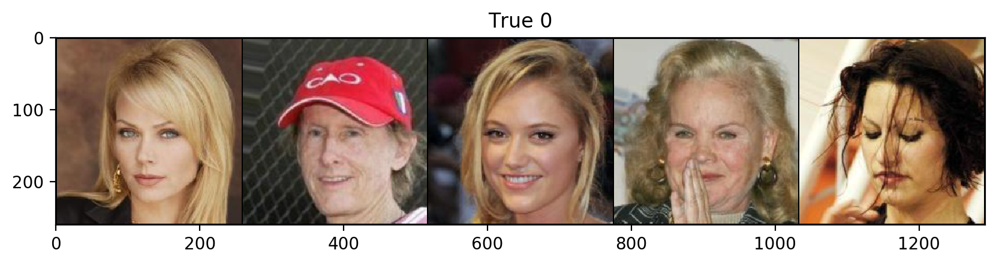

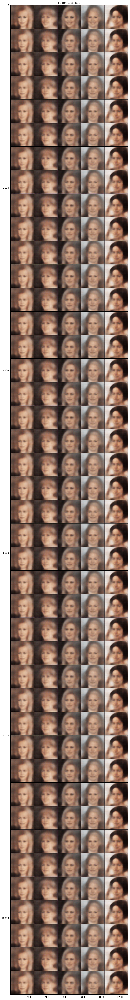


 11%|█         | 152/1425 [02:40<22:09,  1.04s/it]


 21%|██▏       | 303/1425 [05:19<19:44,  1.06s/it]


 32%|███▏      | 454/1425 [07:59<17:08,  1.06s/it]


 42%|████▏     | 605/1425 [10:38<14:27,  1.06s/it]


 53%|█████▎    | 756/1425 [13:18<11:50,  1.06s/it]


 64%|██████▎   | 907/1425 [15:58<09:07,  1.06s/it]


 74%|███████▍  | 1057/1425 [18:37<06:29,  1.06s/it]


 85%|████████▍ | 1205/1425 [21:14<03:52,  1.06s/it]


 85%|████████▍ | 1209/1425 [21:18<03:49,  1.06s/it]

In [ ]:
%%time
for epoch in range(epochs_trained, epochs + epochs_trained):
    train(epoch)
    
    if epoch % 1 == 0:
        test(epoch)
        save(epoch)

In [ ]:
save(epoch)